In [96]:
# import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import pickle
import plotly.express as px
import feather

In [49]:
df_cancer = pickle.load(open('df_cancer_processed.pkl','rb'))
df_fips = pickle.load(open('df_fips.pkl','rb'))
df_pp = pickle.load(open('df_powerplant_processed.pkl','rb'))
df_pp_summary = pickle.load(open('df_pp_summary.pkl','rb'))
df_superfund = pickle.load(open('df_superfund_geo_processed.pkl','rb'))
df_superfund_summary = pickle.load(open('df_superfund_summary.pkl','rb'))


In [50]:
df_combined = df_cancer.merge(df_superfund_summary, how = 'left').merge(df_pp_summary, how = 'left')

In [53]:
df_combined.head()

,location,fips,cancer_per100k,cancer_95ciL,cancer_95ciH,avg_annual_count,recent_trend,trend5yr,trend5yr_95ciL,trend5yr_95ciH,...,pp_petcoke,pp_solar,pp_storage,pp_waste,pp_wind,avg_capacity_mw,avg_commissioning_year,avg_generation_gwh_13_17,sum_capacity_mw,num_pp
0,"US (SEER+NPCR)(1,10)",0,448.0,447.7,448.4,1638110,falling,-0.9,-1.6,-0.1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"Union County, Florida(6,10)",12125,1135.0,1063.6,1210.1,208,falling,-4.6,-5.1,-4.1,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0
2,"Logan County, Nebraska(6,10)",31113,677.2,455.0,974.3,7,stable,1.2,-41.0,73.4,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0
3,"Powell County, Kentucky(7,8)",21197,646.2,586.6,710.3,92,stable,1.1,-0.4,2.6,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0
4,"Taylor County, Kentucky(7,8)",21217,623.3,583.7,665.0,196,rising,1.4,0.7,2.2,...,0.0,0.0,0.0,1.0,0.0,5.0,1996.0,11.487128,5.0,1.0


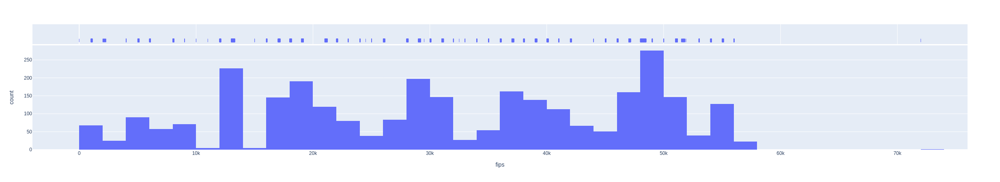

In [66]:
fig = px.histogram(df_combined, x = "fips", marginal="rug", # can be `box`, `violin`
                         hover_data=df_combined.columns[-8:])
fig.show()

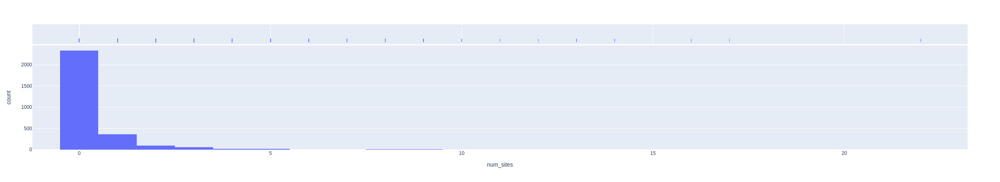

In [99]:
fig = px.histogram(df_combined, x = "num_sites", marginal="rug", # can be `box`, `violin`
                         hover_data=df_combined.columns[-8:])
fig.show()

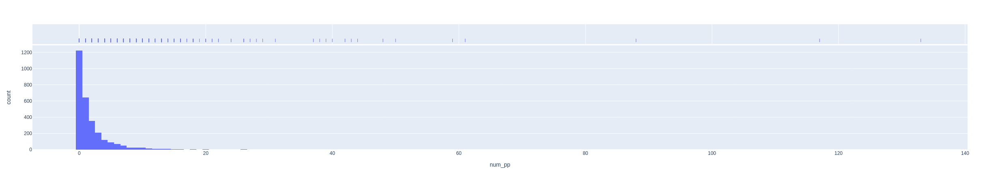

In [100]:
fig = px.histogram(df_combined, x = "num_pp", marginal="rug", # can be `box`, `violin`
                         hover_data=df_combined.columns[-8:])
fig.show()

In [67]:
df_cancer.head()

,location,fips,cancer_per100k,cancer_95ciL,cancer_95ciH,avg_annual_count,recent_trend,trend5yr,trend5yr_95ciL,trend5yr_95ciH
0,"US (SEER+NPCR)(1,10)",0,448.0,447.7,448.4,1638110,falling,-0.9,-1.6,-0.1
1,"Union County, Florida(6,10)",12125,1135.0,1063.6,1210.1,208,falling,-4.6,-5.1,-4.1
2,"Logan County, Nebraska(6,10)",31113,677.2,455.0,974.3,7,stable,1.2,-41.0,73.4
3,"Powell County, Kentucky(7,8)",21197,646.2,586.6,710.3,92,stable,1.1,-0.4,2.6
4,"Taylor County, Kentucky(7,8)",21217,623.3,583.7,665.0,196,rising,1.4,0.7,2.2


In [68]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import plotly.express as px

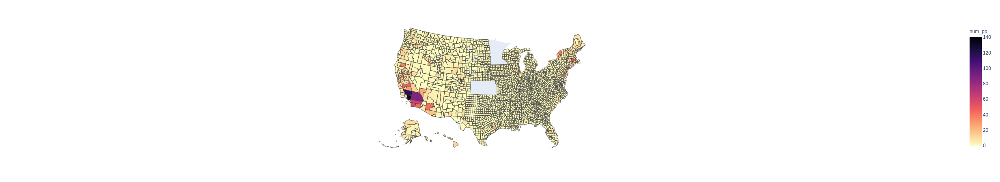

In [89]:
#POWERPLANTS
fig = px.choropleth(df_combined, geojson=counties, locations='fips', color='num_pp',
                           color_continuous_scale="magma_r",
                           range_color=(0, 140),
                           scope="usa",
                           labels={'cancer_per100k':'Adj. cancer rate per 100k'}
                          )
fig.show()

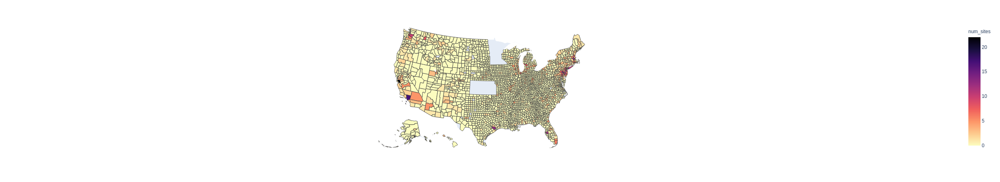

In [84]:
#SITES
fig = px.choropleth(df_combined, geojson=counties, locations='fips', color='num_sites',
                           color_continuous_scale="magma_r",
                           range_color=(0, 22),
                           scope="usa",
                           labels={'cancer_per100k':'Adj. cancer rate per 100k'}
                          )
fig.show()

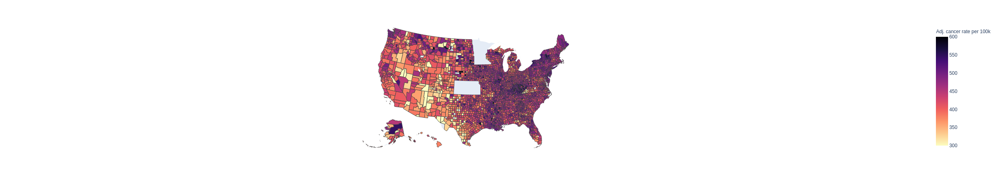

In [94]:
fig = px.choropleth(df_combined, geojson=counties, locations='fips', color='cancer_per100k',
                           color_continuous_scale="magma_r",
                           range_color=(300, 600),
                           scope="usa",
                           labels={'cancer_per100k':'Adj. cancer rate per 100k',
                                  'num_sites':'Superfund Sites'}
                          )
fig.show()

In [98]:
feather.write_dataframe(df_combined,'fips_data.feather')